---
title: "Front-end Web Dev Crash Course Part 2/4"
execute: 
  enabled: false
  freeze: true
date: "11/15/2024"
categories: [javascript, html, css]
---


> This is part 2/4 notes of a <a href="https://www.youtube.com/watch?v=zJSY8tbf_ys">Youtube Front-end web development crash course</a>.

# Lesson 9
<a href="https://youtu.be/zJSY8tbf_ys?t=24353">Video timestamp: JavaScript primitives</a>

## Objects vs Primitive

- Primitive is a simplest form of something. What is Javascript primitive?
    - String
    - Number
    - Boolean
    - Undefined
    - Null
    - BigInt
    - Symbols

- Primitive data types does not have any methods or functions you can call on it. But when use built-in functions on it, Javascript wraped the primitive and changed it into an object behind the scene.
    ```
    // "some string" here is a primitive data type, but when we call .toUpperCase() Javascript convert the primitive to a String() object
    console.log("some string".toUpperCase())
    // [Output] SOME STRING

    ```
- Object != primitive. But as we've seen above, primitive is converted into an object directly behind the scene by Javascript (and it is not something we need to worry about, since Javascript does it for us when needed). Eg:
    ```
    const string1 = new String('Hello, world!'); // an object, note we use the `new` constructor here. and note, it is not recommended to write this way as code may break.
    const string2 = 'Hello, world!' // a primitive, note this is the correct way to create a string.

    // triple equality check for both data types and value
    console.log(string1 === string2); // false

    // double equality check for value
    console.log(string1 == string2); // true
    ```
- What does the `new` operator do?
    - It first creates a blank object, then link the blank object to the parent
    ```
    // creating a new instance of Date() object
    const myDate = new Date();
    ```

# Lesson 10
<a href="https://youtu.be/zJSY8tbf_ys?t=24845">Video timestamp: JavaScript Dates</a>

- Javascript dates
    ```
    const now = new Date();
    
    console.log(now)
    // [Output] Tue Nov 12 2024 07:20:21 GMT+0800 (Malaysia Time)


    // what is actually stored is: the number of miliseconds that have elapsed since midnight on January 1, 1970, UTC.
    console.log(now.valueOf())
    // [Output] 1731367221678
    ```
- How to create date?
    - Input as arguments
        ```
        new Date(2020, 10, 2, 7, 10);
        // Date Mon Nov 02 2020 07:10:00 GMT+0800 (Malaysia Time)
        ```
        - Date(year, month, day, hour, minute, second, milisecond)
        - Note that the minth is 0-indexed. So when we write month=10 (the second argument), we get Nov, instead of Oct.
    - Input as string
        ```
        new Date('Jan 20, 2020');
        // Date Mon Jan 20 2020 00:00:00 GMT+0800 (Malaysia Time)

        new Date('January 22 2020');
        // Date Wed Jan 22 2020 00:00:00 GMT+0800 (Malaysia Time)

        new Date('Jan-23-2020');
        // Date Thu Jan 23 2020 00:00:00 GMT+0800 (Malaysia Time)
        
        new Date('Jan 24 2020 02:20:10')
        // Date Fri Jan 24 2020 02:20:10 GMT+0800 (Malaysia Time)
        ```
    - Input as number (miliseconds)
        ```
        new Date(102031203);
        // Date Fri Jan 02 1970 11:50:31 GMT+0730 (Malaysia Time)
        ```
    - Input as ISO 8601
    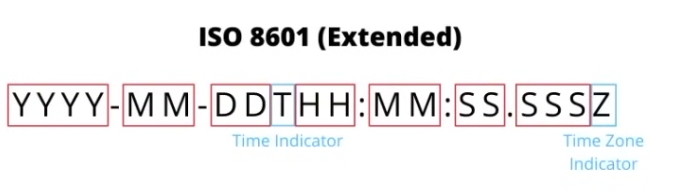
        ```
        new Date('2020-01-20T00:00Z');
        // Date Mon Jan 20 2020 08:00:00 GMT+0800 (Malaysia Time)
        ```
    - Input including timezone specification
        ```
        new Date('Jan 25 2020 02:20:10 -10:00');
        // Date Sat Jan 25 2020 20:20:10 GMT+0800 (Malaysia Time)
        
        new Date('Jan 26 2020 02:20:10 -1000');
        // Date Sun Jan 26 2020 20:20:10 GMT+0800 (Malaysia Time)

        new Date('Jan 27 2020 02:20:10 (EDT)');
        // Date Mon Jan 27 2020 02:20:10 GMT+0800 (Malaysia Time)
        ```
    - NOW (user's local timezone)
        ```
        new Date(Date.now())
        // Date Tue Nov 12 2024 07:41:54 GMT+0800 (Malaysia Time)

        Date.now()
        // 1731368656048

        const myDate = new Date()
        myDate
        // Date Tue Nov 12 2024 07:45:46 GMT+0800 (Malaysia Time)
        ```
- Some operations on on date:
    ```
    const myDate = new Date()
    console.log(myDate.toString())
    // [Output] Tue Nov 12 2024 07:47:38 GMT+0800 (Malaysia Time)
    
    console.log(myDate.toISOString())
    // [Output] 2024-11-11T23:47:38.348Z

    // get day of the month
    console.log(myDate.getDate());
    // [Output] 12    

    // month is 0-indexed, so november is 10.
    console.log(myDate.getMonth());
    // [Output] 10

    console.log(myDate.getFullYear());
    // [Output] 2024
    ```

# Lesson 11
<a href="https://youtu.be/zJSY8tbf_ys?t=25341">Video timestamp: Regular Expressions</a>

- Regular expression can be broken down into 2 pieces:
    - Identifiers: special characters, characters, phrases that we're trying to match. These are what we're trying to pattern match within the string. Eg below is regex of single character and complex pattern example.
        ```
        // ---- Single character regex pattern ----
        const regex = new RegExp('g');

        const string1 = 'my favorite food is steak';
        const string2 = 'my favorite thing to do is code';

        regex.test(string1) // false
        regex.test(string2) // true

        // another way to write regular expression
        /g/.test(string1) // false
        /g/.test(string2) // true


        // ---- Complex regex pattern ----
        const emailValidationRegex = new RegExp('^.+@.+\..+$');
        const userInput = 'invalidemail@g';
        const inValid = emailValidationRegex.test(userInput);
        inValid // false

        ```
    - Quantifiers:
        - Any match 0 or more time: `*`
            ```
            // here we're saying: want to match any lowercase character 0 or more time
            /[a-z]*/.exec(string)
            // [Output] Array ["my"] // matching only "my" because there is a whitespace afterwards
            ```
        - Any match 1 or more after the preceeding character: `+`
            ```
            /[a-z]+/.exec(string)
            // [Output] Array ["my"]
            ```
        - Either 0 or 1 match of the previously defined charater: `?`
            ```
            /[a-z]?/.exec(string1)
            // [Output] Array [ "m" ]
            ```
        - Matching specific quantity: `{number to match}`. Note we can specify range of character we want to match eg to match 1-4 characters: `{1,4}`.
            ```
            // want to find 6 characters matching to the pattern we defined
            /[a-z ]{6}/.exec(string1)
            // [Output] Array [ "my fav" ]

            // want to find 2 to 6 characters matching to the pattern we defined
            /[a-z ]{1,4}/.exec(string1)
            // [Output] Array [ "my f" ]
            ```
- Some special character in regular expression
    - Character group: `[]` eg `[A-Z] [a-z] [0-9] [A-Za-z0-9]`. Note the last example here is combining multiple groups to match all uppercase alphabet, all lowercase alphabet and all digits.
        - Whatever we define in that character group is going to apply to the regular expression.
        ```
        const string1 = 'my favorite food is steak';
        const string2 = 'my favorite thing to do is code';
        const string3 = 'I AM HERE!'

        /[A-Z]/.test(string1) // false
        /[A-Z]/.test(string2) // false
        /[A-Z]/.test(string3) // true
        ```
    - Any character: `.`
    - All digits: `\d`. This is equivalent to `[0-9]`
    - Whitespace: `\s`
    - Any alphanumeric character: `\w`
    - Beginning of the string: `^`
    - End of the string: `$`
    - Groups: `()` eg 
        ```
        /(code|steak)/.test(string1) // true because there is either 'code' or 'steak' in string1
        ```
- Regular expression flag
    - Global search (searching for pattern even if it occurs multiple times): `/pattern we want to search/g`
        ```
        /[a-z]+/g.exec(string1)
        // [Output] Array [ "hello" ]
        ```
    - You can check out many other flags in the <a href="https://developer.mozilla.org/en-US/docs/Web/JavaScript/Reference/Regular_expressions#regex_flags">MDN</a> documentation.

### Reference
- <a href="https://developer.mozilla.org/en-US/docs/Web/JavaScript/Reference/Regular_expressions#regex_flags">MDN/Regex flags</a>

# Lesson 12
<a href="https://youtu.be/zJSY8tbf_ys?t=26702">Video timestamp: JavaScript String methods</a>

- Replace all occurances of something: `ReplaceAll()`
    - Eg 1: Replace raw letters 'Dog' with 'Cat'. This is case sensitive, so notice the lowercase 'dog' in the original sentence is not replaced.
        ```
        const myString = 'My Dog jumped on the bed. My dog is a bad Dog.'

        const newString = myString.replaceAll('Dog', 'Cat');
        console.log(newString)
        // [Output] My Cat jumped on the bed. My dog is a bad Cat.
        ```
    - Eg 2: Replace using regex.
        - `[Dd]`: want to match both uppercase and lowercase d
        - `{1}`: want to match the previous group exactly 1 time
        - `og`: character to match
        - `g`: global flag at the end
        ```
        const correctStr = myString.replaceAll(/[Dd]{1}og/g, 'cat');
        console.log(correctStr)
        // [Output] My cat jumped on the bed. My cat is a bad cat.
        ```
- Get part of the string between the provided start (inclusive) and end (exclusive) indices: `substring()`
    ```
    const myString = 'some string';
    console.log(myString.substring(5,7));
    // [Output] st

    console.log(myString.substring(5));
    // [Output] string
    ```
- Remove whitespace from both ends of the string: `trim()`
- Match pattern in string: `match()`
    - This is similar to using .exec() method with regular expression. We can use any.
    - Both examples below returned the same result (matching to the last character before the 0 digit).
    ```
    const regex = /[a-z]+/
    const str = 'klsjoewpd012-391-20alsd'

    console.log(regex.exec(str))
    // [Output] Array [ "klsjoewpd" ]
    
    console.log(str.match(regex))
    // [Output] Array [ "klsjoewpd" ]
    ```

# Lesson 13
<a href="https://youtu.be/zJSY8tbf_ys?t=27647">Video timestamp: JavaScript Array methods</a>

- General array arrangemet:
    - Add element to end of array: `push()`
    - Remove the last element from an array: `pop()`
    - Remove the first element from an array: `shift()`
    - Add element to the beginning of an array: `unshift()`
        ```
        const arr = [1, 2, 3, 5, 6]
        arr.pop()
        arr.pop()
        arr.push(4,5,6)
        console.log(arr)
        // [Output] Array(6) [ 1, 2, 3, 4, 5, 6 ]

        arr.unshift(0)
        console.log(arr)
        // [Output] Array(7) [ 0, 1, 2, 3, 4, 5, 6 ]
        ```
- Get shallow copy of a portion of an array: `slice()`. Shallow copy is does not copy the entire array if the array is nested, it only takes the first layer.
    ```
    
    arrCopy = arr.slice();
    console.log(arrCopy)
    // [Output] Array(7) [ 0, 1, 2, 3, 4, 5, 6 ]

    anotherCopy = arr.slice(3);
    console.log(anotherCopy)
    // [Output] Array(4) [ 3, 4, 5, 6 ]
    ```
- Remove / replace (in place) the content in the middle of an array: `splice()`
    ```
    const arr = [1, 2, 3, 'opps', 4,  5, 6]

    arr.splice(3, 1, 3.5)
    arr
    // [Output] Array(7) [ 1, 2, 3, 3.5, 4, 5, 6 ]
    ```
- Get indexes method:
    - Get the index of first matching element in the array (or -1 if no match):`findIndex()` or `indexOf()`. `findIndex()` is more powerful.
    ```
    // ---- Example 1: simple array search ----
    const arr = [1, 2, 3, 'opps', 4,  5, 6]
    console.log(arr.indexOf('opps'))
    // [Output] 3

    const moreComplexArr = [
                            {firstname: 'Bob',
                            lastname: 'Smith'},
                            
                            {firstname: 'Alice',
                            lastname: 'Smith'},
                            
                            {firstname: 'Jon',
                            lastname: 'Smith'},
                            
                            {firstname: 'Jon',
                            lastname: 'Doe'}
                            ]

    console.log(moreComplexArr.indexOf({firstname: 'Bob'}))
    // [Output] -1 // not found

    console.log(moreComplexArr.findIndex((arrItem) => {
        return arrItem.lastname !== 'Smith';
    }))
    // [Output] 3
    ```
- Loop through the array and perform transformation according to the callback function provided to each array element: `map()`
    ```
    const blogPostsFromDatabase = [
                    {title: 'How to use the map() function',
                    category: 'uncategorized'},
                    
                    {title: 'What is JavaScript?',
                    category: 'uncategorized'},
                    
                    {title: 'Why are you crazy enough to learn to code?',
                    category: 'uncategorized'},
                    ];

    blogPostsFromDatabase.map(arrItem => {
        arrItem.category = 'Web Development';
        return arrItem
    })

    blogPostsFromDatabase
    /* [Output] Array(3) [ {…}, {…}, {…} ]
        0: Object { title: "How to use the map() function", category: "Web Development" }
        1: Object { title: "What is JavaScript?", category: "Web Development" }
        2: Object { title: "Why are you crazy enough to learn to code?", category: "Web Development" }*/
    ```

- A simpler way to loop through array: `forEach()`
    ```
    const arr = ['aaa', 'bbb', 'ccc']
    arr.forEach((arrItem) => {
        console.log(arrItem)
    })
    /* [Output] aaa
                bbb
                ccc*/

    arr.forEach((arrItem, index) => {
        console.log(index, arrItem)
    })
    /* [Output] 0 aaa
                1 bbb
                2 ccc*/


    // Another way to do this is using for loop
    for(let i = 0; i < arr.length; i++){
        console.log(i, arr[i]);
    }
    /* [Output] 0 aaa
                1 bbb
                2 ccc*/
    ```
- Find if an element is exist in an array: `includes()`. We could achieve the same result using for loop, forEach etc, but `includes()` is by far the simplest way.
    ```
    const myColors = ['blue', 'red', 'purple', 'orange', 'green'];

    // Using for loop
    let orangeExist = false;
    for (let i = 0; i < myColors.length; i++){
    if (myColors[i] === 'orange'){
        orangeExist = true;
    }}
    console.log(orangeExist) // true

    // using forEach
    orangeExist = false;
    myColors.forEach((arrItem) => {
    if (arrItem === 'orange'){
        orangeExist = true;
    }})
    console.log(orangeExist) // true

    // using includes
    myColors.includes('orange'); // true
    ```
- Filters from array based on provided callback function: `filter()`
    ```
    const allOrders = [
                    {productName: 'Tea pot',
                    isDigital: false,
                    isCancelled: false,
                    isOpen: false},
                    
                    {productName: 'Blue Gildan Mens Hoodie',
                    isDigital: false,
                    isCancelled: true,
                    isOpen: false},
                    
                    {productName: 'Code Complete Kindle Book',
                    isDigital: true,
                    isCancelled: true,
                    isOpen: false},
                    
                    {productName: 'Atomic Habits Kindle Book',
                    isDigital: true,
                    isCancelled: false,
                    isOpen: false},
                    ];

    const digitalOrders = allOrders.filter((arrItem) => {
        return arrItem.isDigital
    })

    digitalOrders
    /* [Output] Array [ {…}, {…} ]
    0: Object { productName: "Code Complete Kindle Book", isDigital: true, isCancelled: true, … }
    1: Object { productName: "Atomic Habits Kindle Book", isDigital: true, isCancelled: false, … }
    */
    ```
- Do accumulation operation on an array (eg sum, average etc): `reduce()`
    ```
    const arr = [10, 20, 30, 25, 14];

    // for loop
    let sum = 0;
    for (let i = 0; i < arr.length; i++){
            sum += arr[i];
            }
    console.log(sum);
    // [Output] 99

    // reduce method
    function reducerCallback(sum, arrItem) {
                return sum += arrItem;
                }
    const result = arr.reduce(reducerCallback, 0)
    console.log(result)
    // [Output] 99

    // more simplified way to write reduce method
    console.log(arr.reduce((sum, arrItem) => sum += arrItem, 0))
    // [Output] 99

    // example on how to calc average using reduce method
    console.log(arr.reduce((sum, arrItem) => sum += arrItem, 0) / arr.length)
    // [Output] 19.8
    ```

# Lesson 14
<a href="https://youtu.be/zJSY8tbf_ys?t=29802">Video timestamp: Math utilities with JavaScript</a>

- Math methods are static methods, not instance methods like String, Date, Array methods (where we have to construct an instance of that object and call the methods on the instance we created). Math methods are like functions.
    ```
    console.log(Math.PI) // 3.141592653589793
    console.log(Math.E) // 2.718281828459045
    console.log(Math.abs(-60)) // 60
    console.log(Math.ceil(Math.PI)) // 4
    console.log(Math.floor(Math.PI)) // 3
    console.log(Math.round(Math.PI)) // 3
    console.log(Math.min(2,3,4,5)) // 2
    console.log(Math.max(2,3,4,5)) // 5
    console.log(Math.random()) // return random decimal between 0-1
    ```
- To get random index from an array: 
    - `Math.random()` return random decimal between 0-1.
    - When we multiply with `arr.length`, we will get random decimal between `0-arr.length`.
    - To get whole number, we use `Math.floor`.
    - We can then use this whole number to retrieve random element from an array.
    ```
    // Example of how we would get random index for an array
    const arr = ['some', 'values', 'blah', 'meh']
    const randomIndex = Math.floor(Math.random() * arr.length)

    console.log(arr[randomIndex])
    // [Output] meh
    ```

# Lesson 15
<a href="https://youtu.be/zJSY8tbf_ys?t=30192">Video timestamp: Error types and other JavaScript concepts</a>

- Some mostly used base class errors (parent error type): `ReferenceError, SyntaxError, TypeError`.
- Error handling: `try {do something} catch (error) { run this if error}`
    ```
    try {
        const num = 20;
        num.toUpperCase()
    } catch (err) {
        console.log(err instanceof TypeError);
        console.log(err.message);
    }

    /* [Output] true
                num.toUpperCase is not a function */

    ```

### References
- <a href="https://developer.mozilla.org/en-US/docs/Web/JavaScript/Reference/Global_Objects/Error#error_types">MDN/Error types</a>: Base class error types

# Lesson 16
<a href="https://youtu.be/zJSY8tbf_ys?t=31156">Video timestamp: 10 Beginner / Intermediate JavaScript practice problems</a>

# Lesson 17
<a href="https://youtu.be/zJSY8tbf_ys?t=36154">Video timestamp:HTML Crash Course</a>

## HTML tags
- If a website is a house:

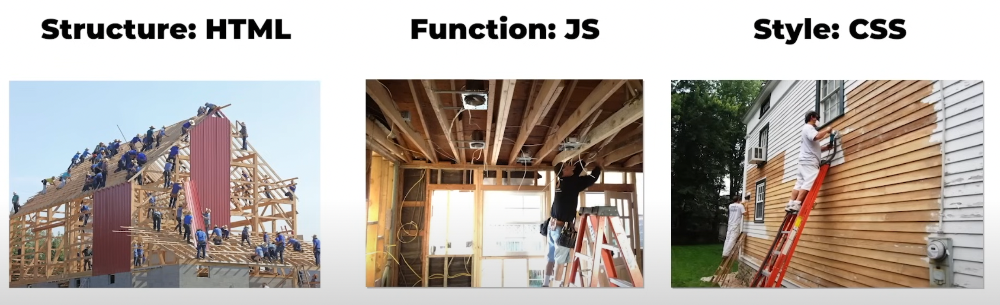

- What is HTML?
    - Stands for HyperText Markup Language.
    - Something that allows you to structure the components that you're going to put on a webpage.
    - Each website has 1 HTML document within it. This HTML document has general structure.
    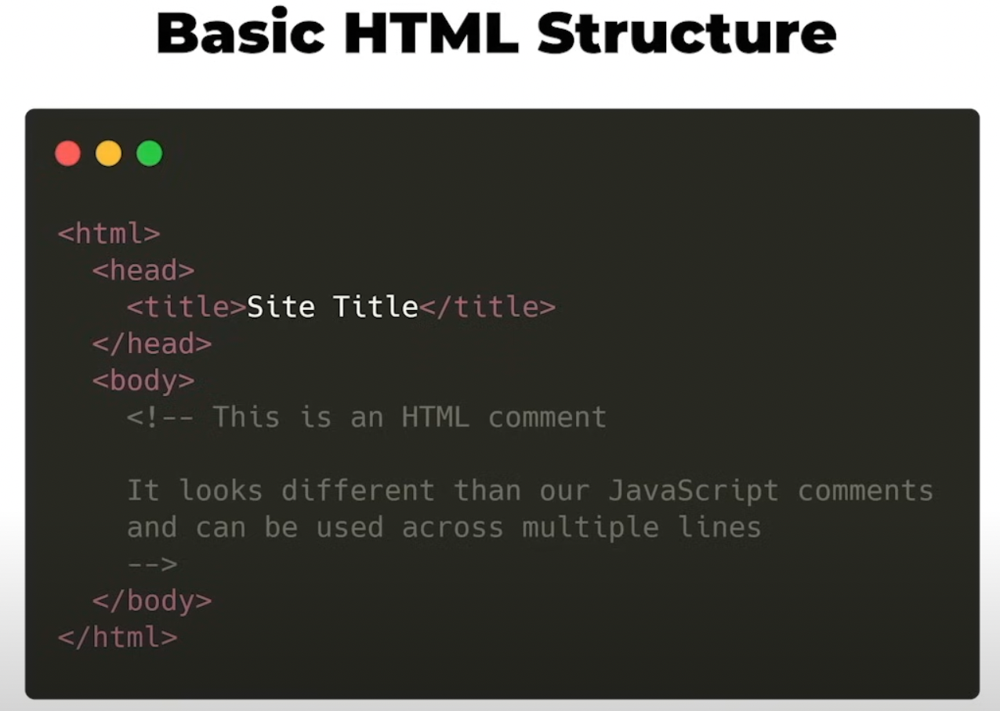
    - Everything within `<html></html>` tag defined the whole document.
    - Within the html tags, you'd have `<head></head>` tag, that has `<title></title>` tag -- this define the name you see on the browser tab.
    - The bulk of your website is defined within `<body></body>` tag.
    - Below is a standard boilerplate that has HTML, CSS and Javascript.
        - `<link></link>` tag references the CSS stylesheet.
        - `<script></script>` tag references the javascript script that is connected to this HTML that gives it function.
    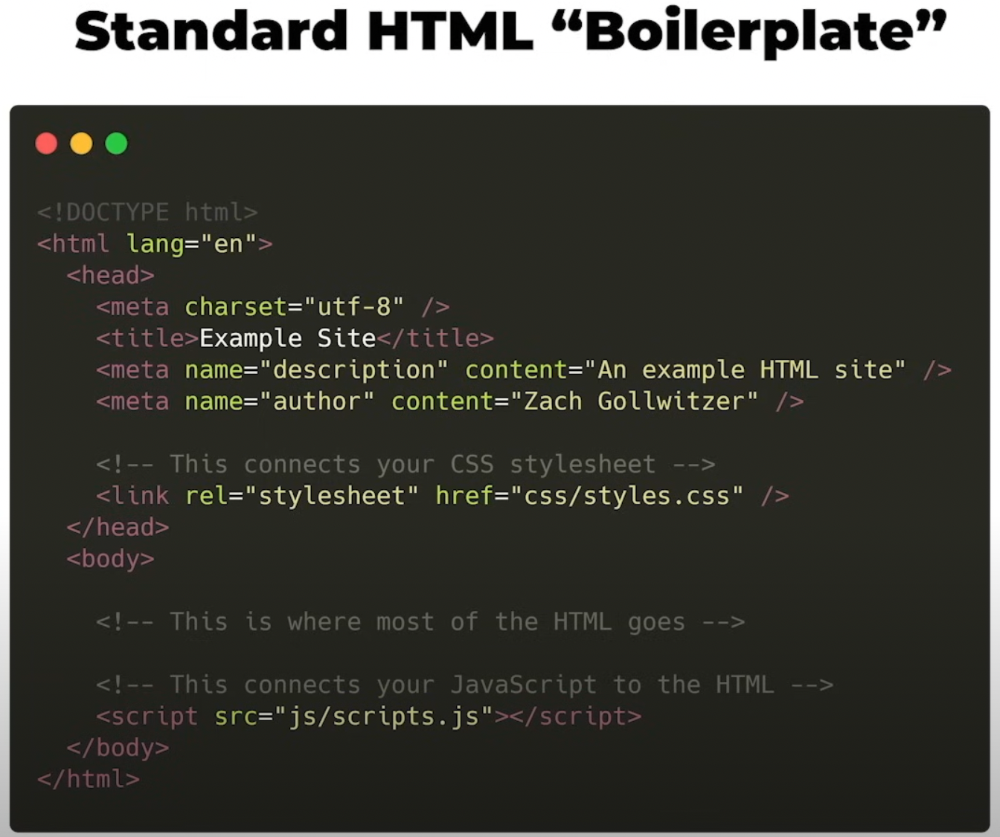
    - Basic anatomy of a HTML element.
        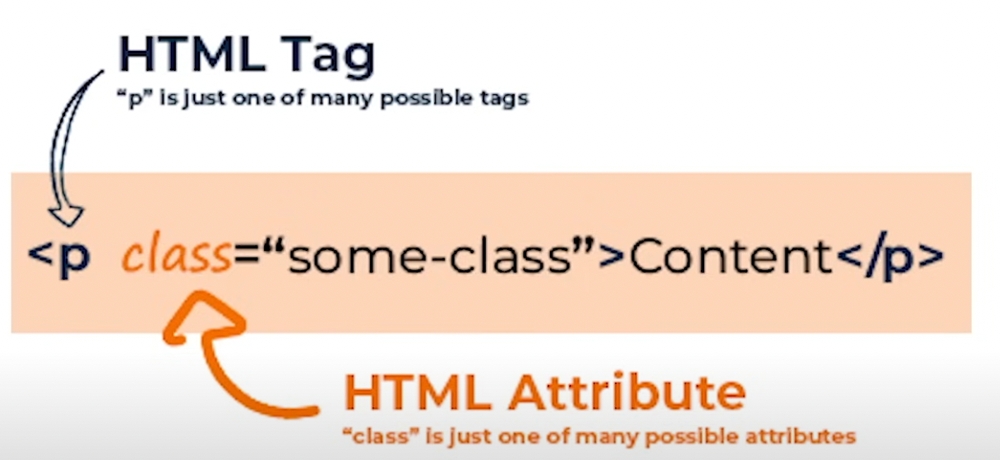
        - The `class` attribute of a HTML element is how we identify the HTML tag from CSS. But this doesn't mean all HTML attributes relate to CSS.
- HTML element vs HTML tag:
    - HTML element: A complete unit (ie tag + attributes + event listeners etc). Can also think of it as the general structure of that HTML. Eg. `<p id="p1" class="some-class">Content Here</p>`
    - HTML tag: Think of it as the function -- what the element is supposed to be doing. Eg. `<p></p>`
- Types of HTML tags:
    - Normal HTML tags: tag with opening and closing
        ```
        <p></p>
        <h1></h1>
        <div></div> --> generic container element
        <span></span> --> use this to style. Can be nested within other tags eg `<p></p>`
        <strong></strong> --> make something bold
        <em></em> --> make something italic
        <a></a> --> to add hyperlink to HTML. Must contain `href` attribute
        <button></button> --> add clickable button
        <ul></ul> --> unordered list (bullet points)
        <li></li> --> nested inside <ul></ul>. Represent an element in a list
        <ol></ol> --> ordered list (numbered list)
        <table></table> --> table as a container
        ```
        - We can nest other HTML tags within these normal tags. Especially for tags that are meant to be used as container-like (eg the `<div></div>` tag.)
        - But for some tags (eg the paragraph tag), it does not make sense to nest other tags within them.
    - Self-closing HTML tags: 
        ```
        <img /> --> use this to attach image to the HTML
        <input /> --> use this to create interactive controls to accept user input
        <meta /> --> this goes in the head of the HTML document
        <link /> --> this is how we link the style sheet with HTML
        ```
        - Can not nest other HTML tags within these self-closing tags.
- HTML is not case sensitive. `<p></p>` == `<P></P>` both works fine.
- HTML does not care about line breaks.
- In new HTML 5 standards, it is recommended to only do styling from CSS and not within HTML.
- How to connect HTML button to event listener:
    ```
    // in HTML
    <button onclick="alertMe()">Submit</button>

    // in JavaScript
    function alertMe(){
        alert('Button is clicked')
    }
    ```
    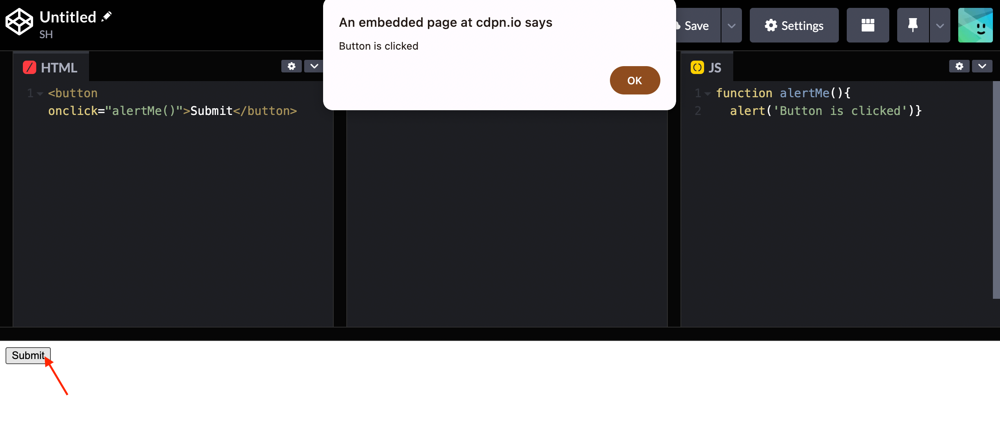

## HTML attributes
- Global attribute vs Element specific attribute:
    - Global attribute: attributes that's available to any HTML element
    - Element specific attribute: Only applicable to certain elements
    - In the example below:
        - `src` and `width` are element specific attributes. Think of these as methods that are only applicable to certain objects. Eg, toUpperCase() is only applicable to string object and won't do anything on number object.
        - `class` attribute is global attribute
    ```
    <img src="https://...." class="some-style" width="200">
    ```

# Lesson 18
<a href="https://youtu.be/zJSY8tbf_ys?t=39771">Video timestamp:Document Object Model (DOM)</a>

## About working in Codepen
- If we are working in codepen and wanted to test out Javascript code before adding into the JS section of the codepen, we could use the console to do this. Here's how:
    1. Right click anywhere on the page &rarr; Inspect
    2. In the dropdown, select `CodePen (Index.html)` environment, this will make sure we are refering to the right context.
    3. Now we can use `document.queryselector()` to get tags from our Codepen HTML section.
    
    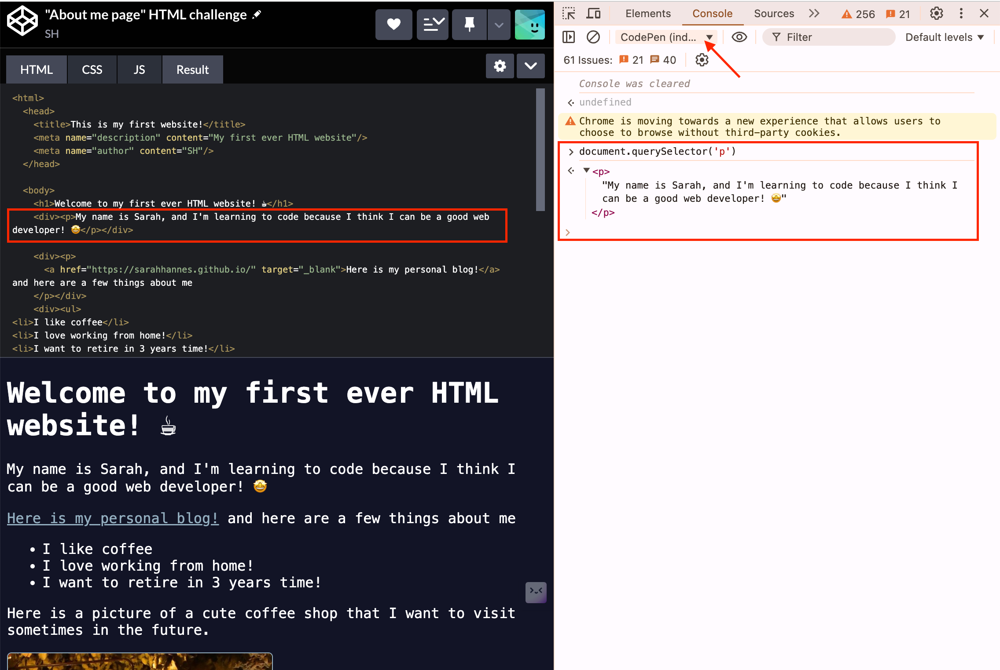
- The codepen environment has already do the necessary linking of Javascript and CSS to the HTML script, so we don't need to do it manually.
- Codepen has already wrapped the HTML document within `<html></html>` tag, so we don't have to do this. Whatever we inserted in the HTML panel within the codepen is inserted within `<body></body>` tag.
    - How do we know this? In the console, we retrieved the entire HTML document and notice that there are html and head tags which we did not define in the codepen HTML panel.
    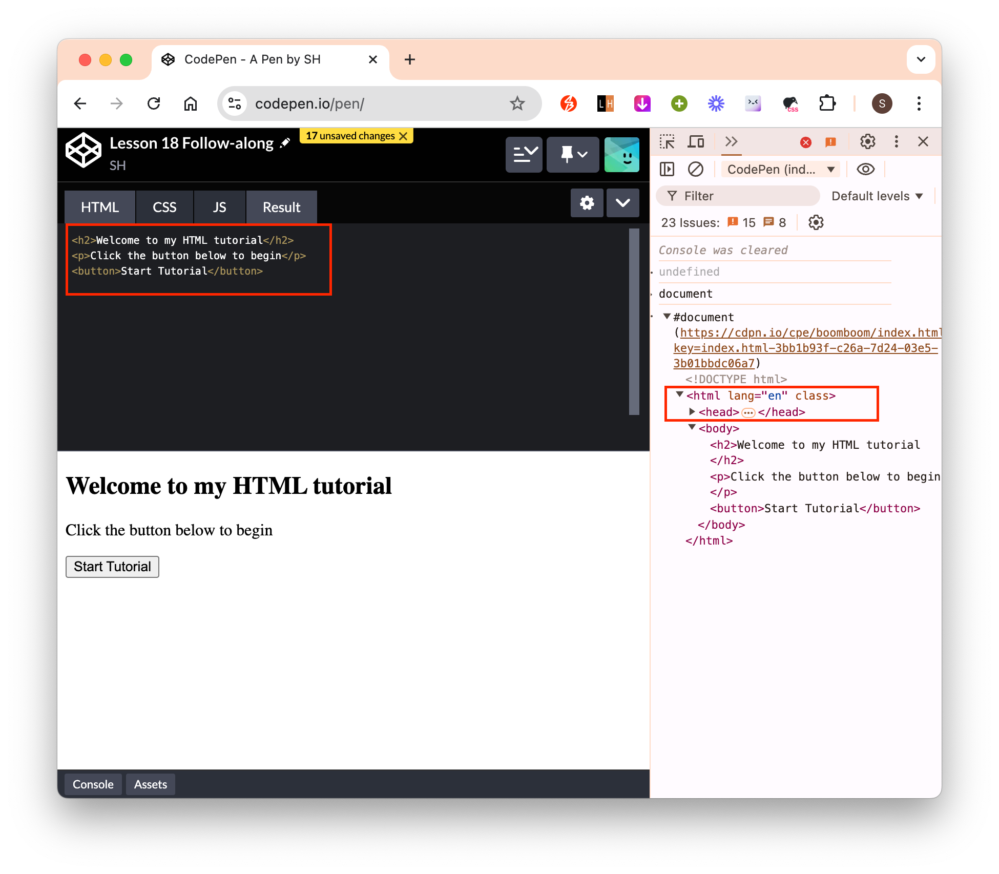

## Document Object Model (DOM)
- Think of it as a bridge between HTML and Javascript.
- DOM is the root of any front-end framework we'll work with.
- What is DOM?
    - not a programming language
    - not natively part of Javascript
    - only exist within the browser (all browsers have slightly different implementation of the DOM)
    - can think of it as an API for an HTML document
    - allow us to manipulate HTML without knowing how is HTML being manipulated by the browser
- HTML alone is like paper map, but when we add the DOM API + HTML then we can make it like a google map, where we introduce a lot of interactivity into it.
- <a href="https://developer.mozilla.org/en-US/docs/Web/API/Element">Element</a> is the most general base class for which all element objects in a document inherit.
- Relationship between HTML and DOM:
    - At the highest level, DOM has 2 built-in objects that we'll probably use more than any other objects that you'll look at.
    - At the very top level, you have the `window` object.
        - We can think this as literally the individual browser tab we're working with.
        - We can program using this one object and do all sorts of things within a browser (eg scrolling, resizing browser window, refreshing the page) -- we can do these using Javascript by connecting it to DOM via the top level `window` object.
    - DOM is an API to connnect to our browser in our HTML document.
    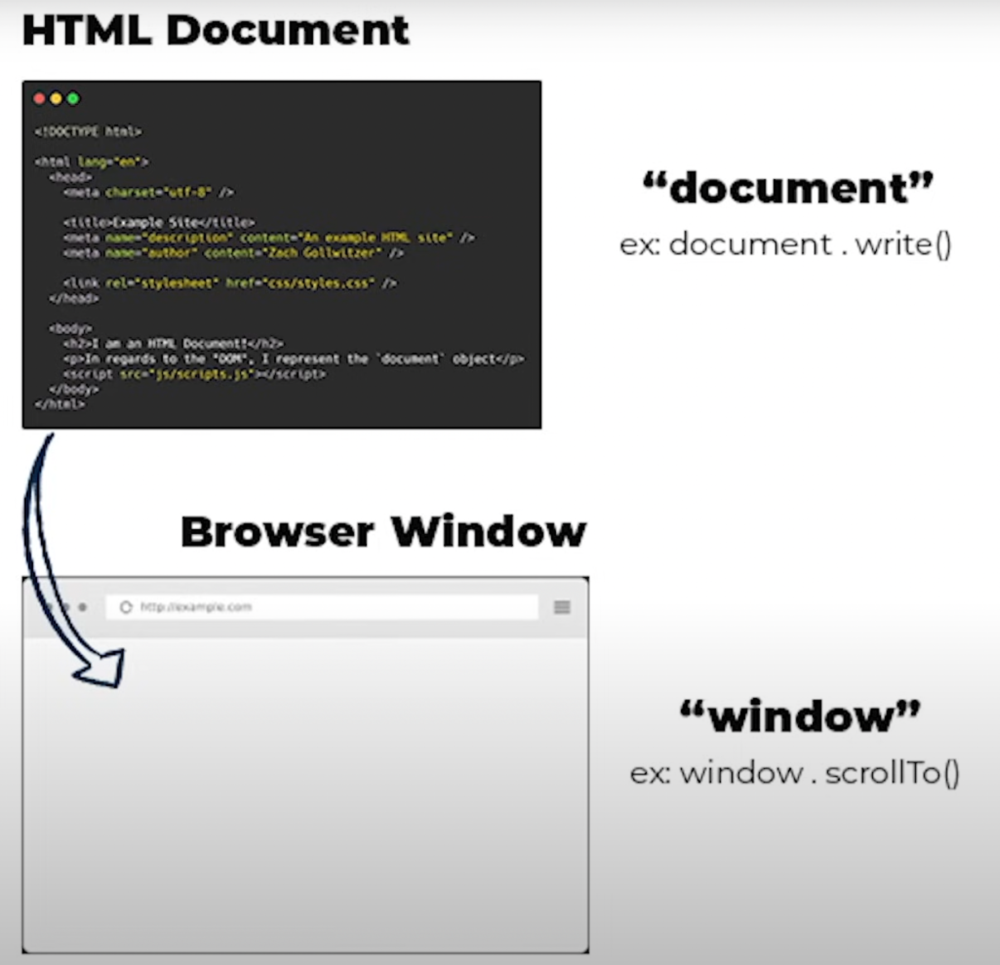
- `document` is a representation of the entire HTML document we've written. To access this we use `window.document`.
    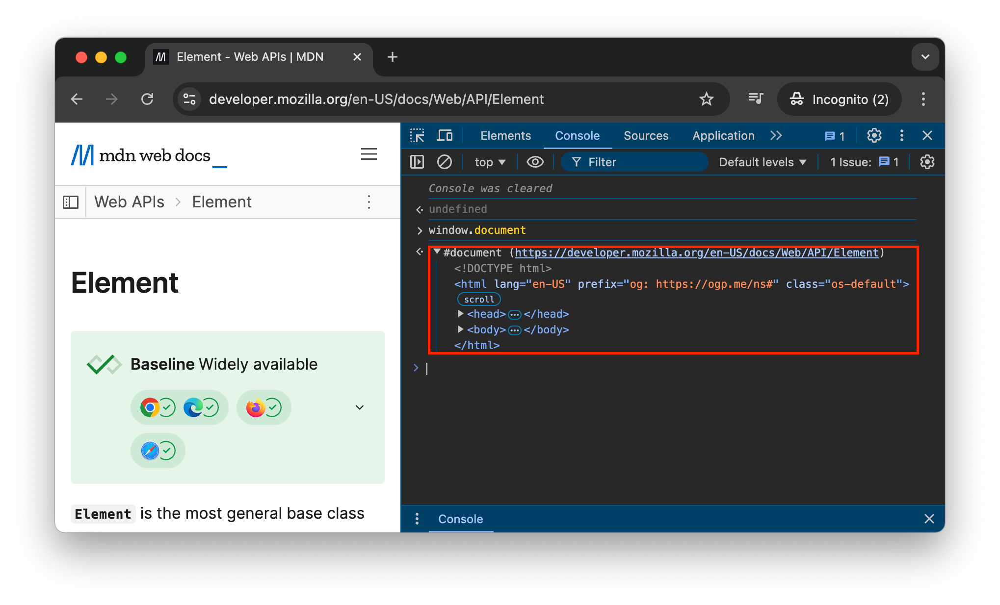
- Think of the HTML document as a tree
    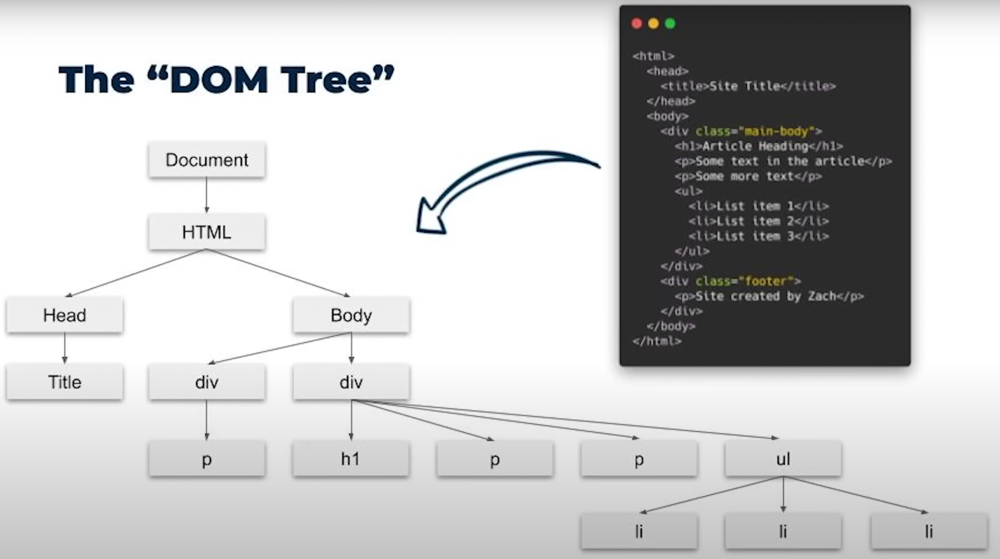
    - In the document object model, we call all of the elements as nodes within the DOM tree.
    - Each element is defined as a total unit which is made of several different type of nodes:
        
        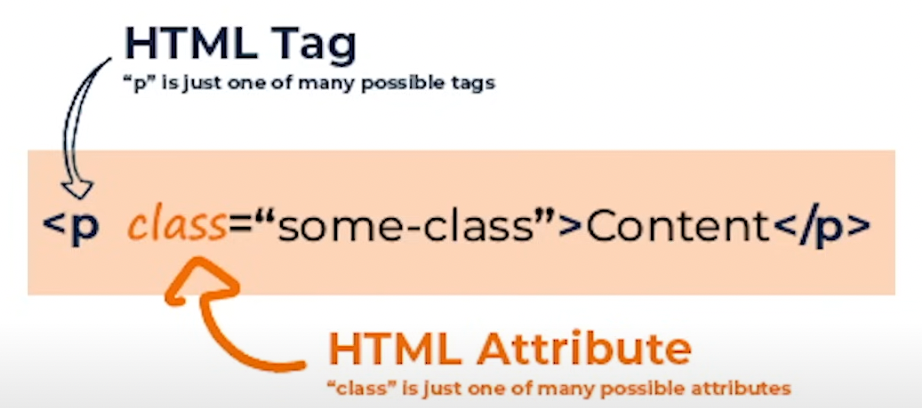
        
        - the simplest level: element node Eg. `<p>`
        - the attributes: attribute node Eg. `class="some-class"`
        - the content: content node Eg. `Content`
    - We can create the above element entirely in Javascript and insert it into the HTML document using DOM API as shown below.
    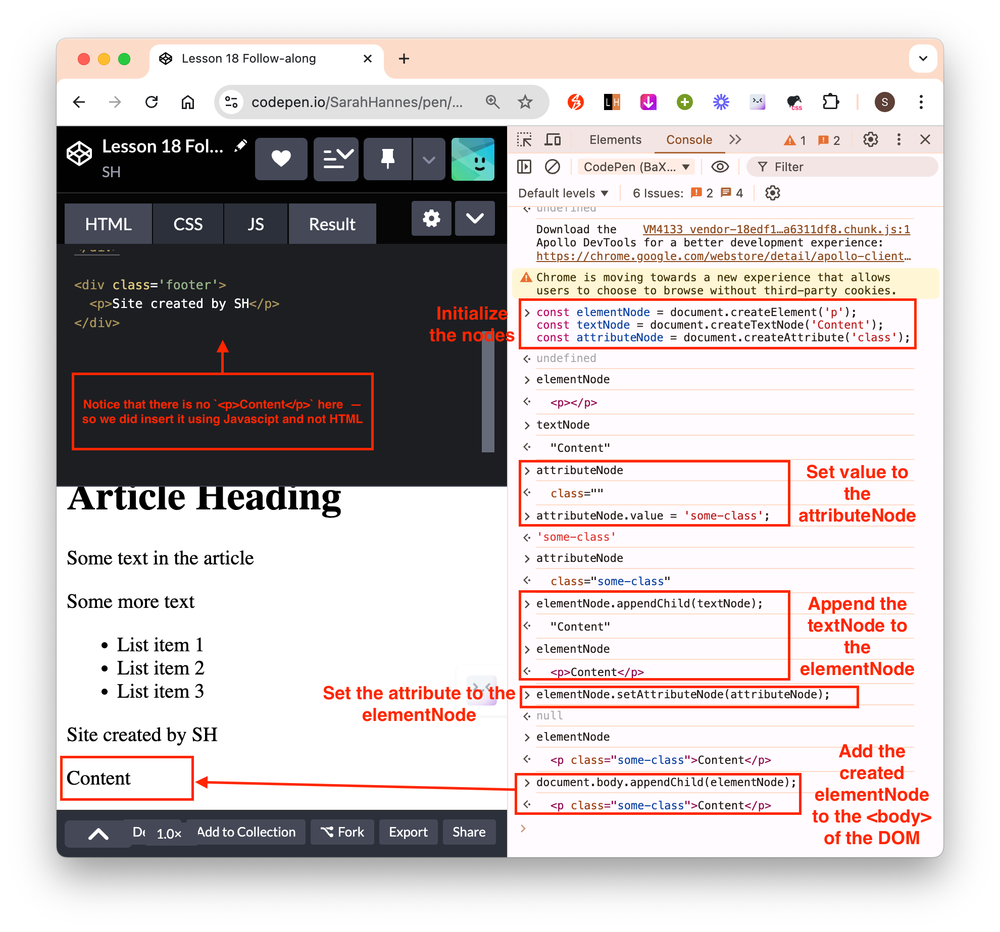
        - However, this inserted element is temporary. We normally use it for user experience -- when user does some changes on the website, we want to immediately show the changes, and this can be done using Javascript through the DOM API to modify elements that are existing within the HTML.
        - We later can save the changes to the database and reload it with new data later -- which might take a while, so we use Javascript + DOM for faster response.

## Window
- We can use the top level `window` object to control over the browser. Examples on how we can manipulate the top level object `Window` via the DOM API ():
    - To throw a popup alert: In Inpect &rarr; Console tool, we can make the browser show a popup using `window.alert(message)` or we could just directly write `alert(message)` -- we don't even need to reference to `window` because it is the global object.

    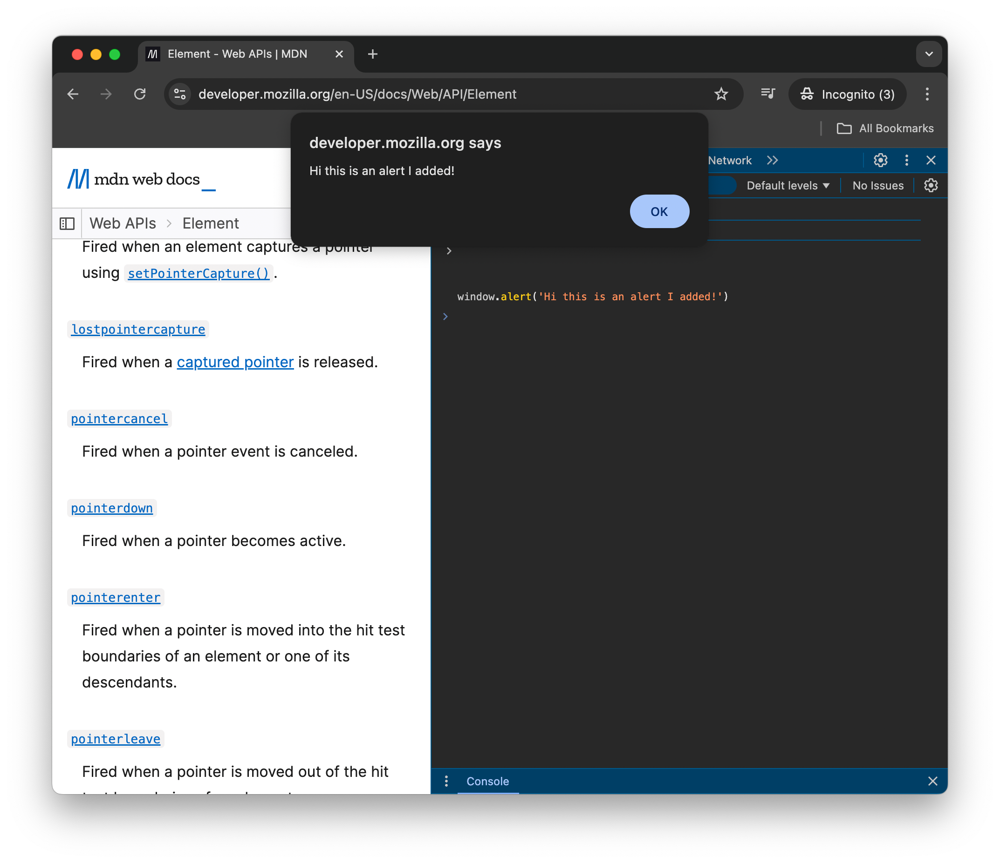
    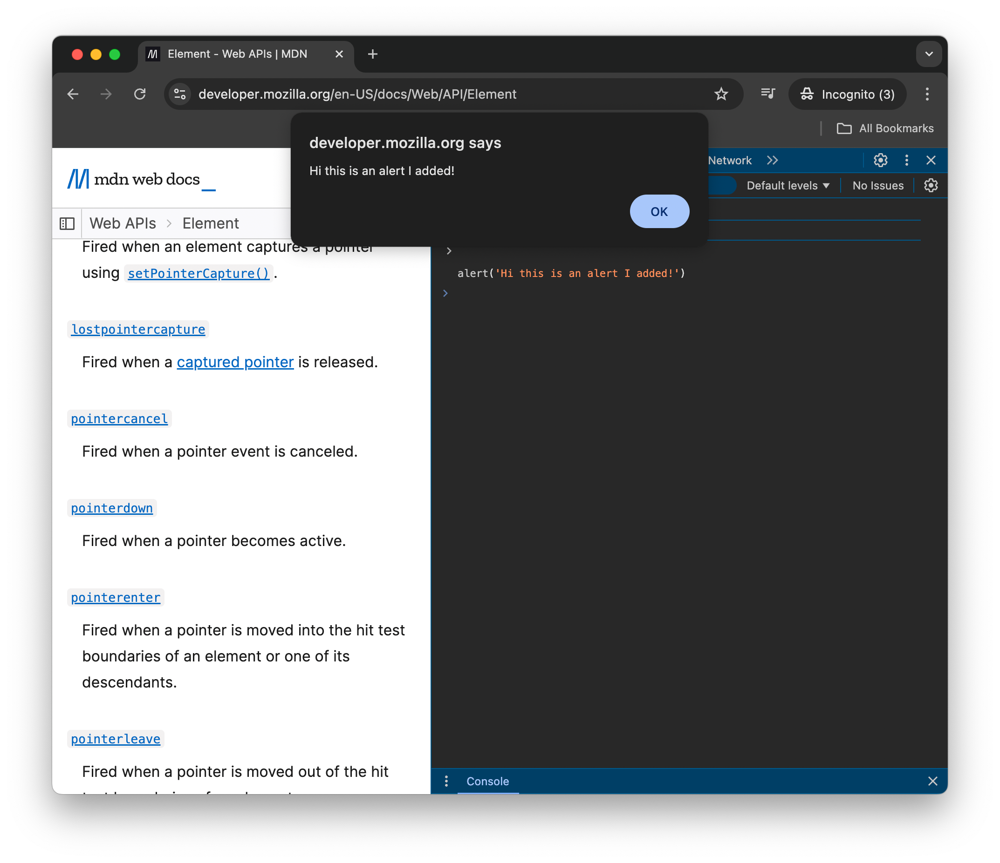
    - To open a new tab: `window.open(url to open)`
    - To scroll down a page:
        ```
        window.scrollBy({
            top: window.innerHeight*100, // window.innerHeight is only the height in the current view, not the entire length of the browser tab (the total webpage height is window.outerHeight)
            left: 0,
            behavior: 'smooth'
        });
        ```
    - To reload a page: `window.location.reload();`
- Some global properties are (can be refered by `window.{property}` or just `{property}` eg `window.innerHeight` or `innerHeight`):
    - Height / width of current view: `innerHeight`, `innerWidth`
    - Total height / width of the webpage (full scrollable length): `outerHeight`, `outerWidth`.
    - Allows you to store data temporarily in the browser: `localStorage`.
        - You can check the temporarily saved data in Application tab of the Developer Inspect tool.
        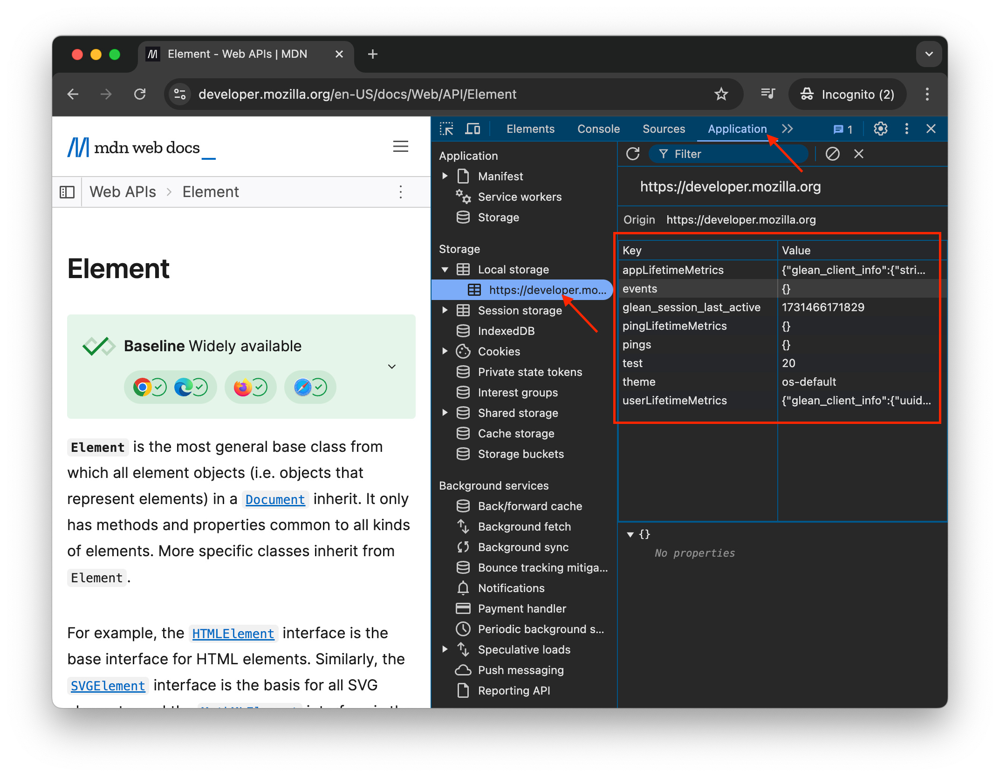
        - You can temporarily save data using the Console tool. Eg. `localStorage.setItem(key, value)`.
        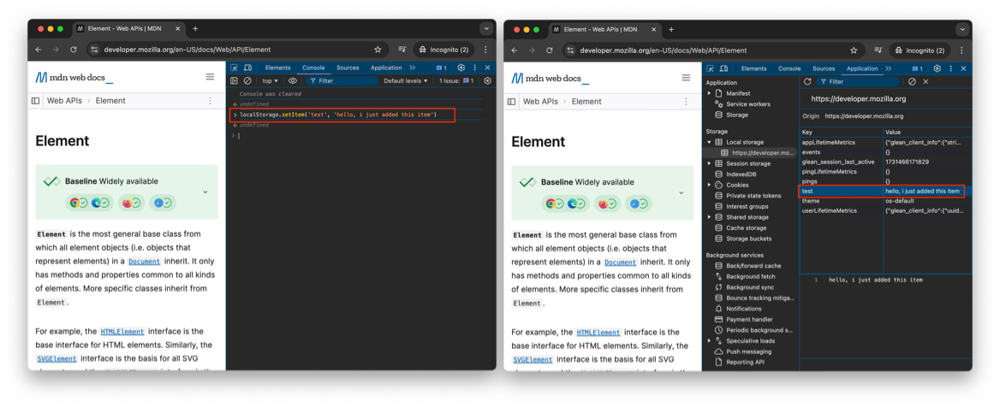
    - Get information about the website the current tab is on: `location`
        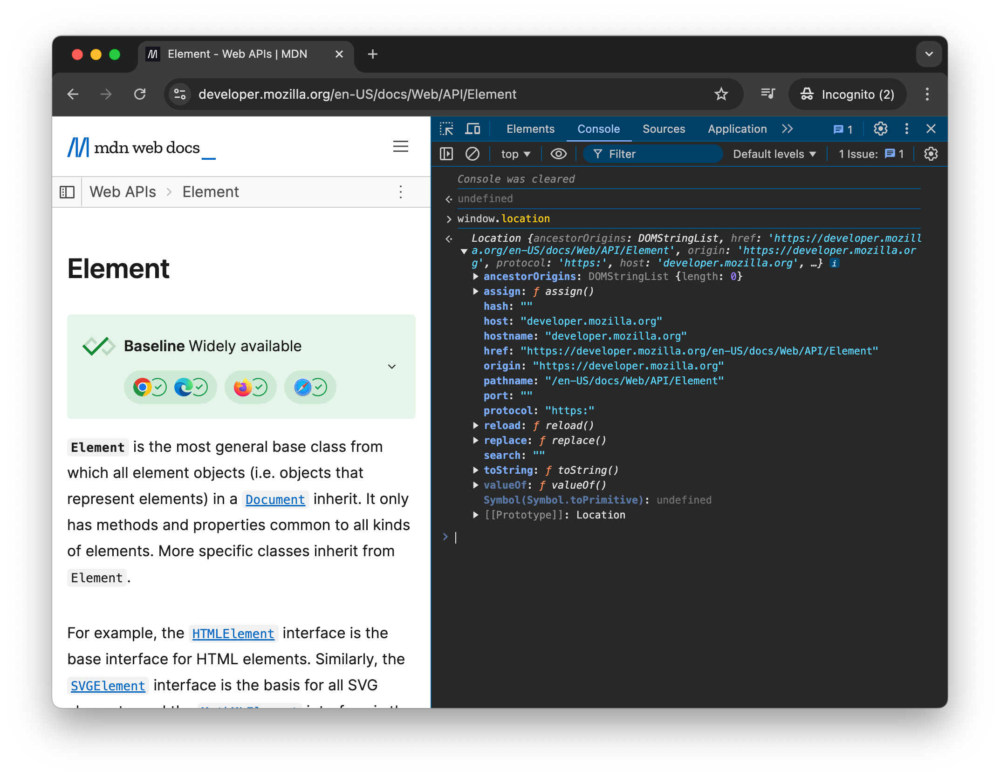
    - Information on how much we've scrolled (left-right) and (up-down) respectively: `scrollX`, `scrollY`
- Setting up event listener on the entire window
    - We set up a function that will be triggered everything user scroll the webpage.
    - Notice there are 44 printed "hi" on the Console.
    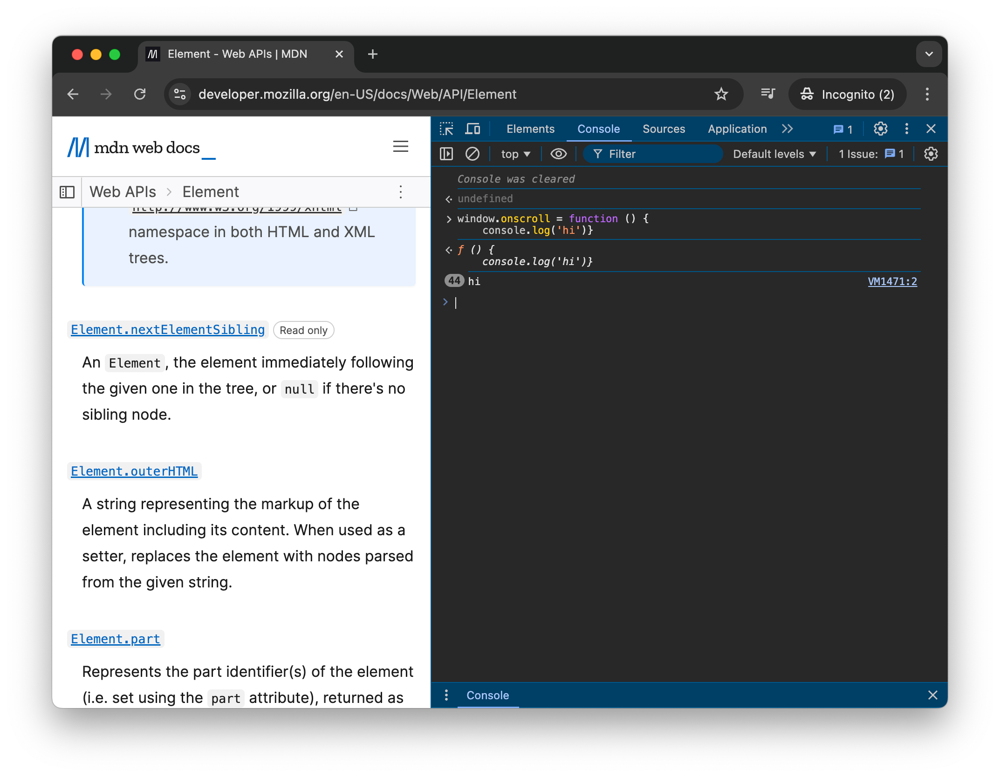

## HTML Element
- Global attribute: Attributes that we can set for every HTML element
    - `id`: Eg. `<button id="btn-1"></button>`
    - `class`: Eg `<button class="my-btn"></button>`

## Add interactivity
- To add interactivity on HTML page, we need to do 3 steps:
    1. Identify the element we want to add user interactivity on (eg a button element).
    2. Register event listener on the element (eg a click event).
    3. Create a function that will insert/ made changes to the HTML document every time user interacted with the element.

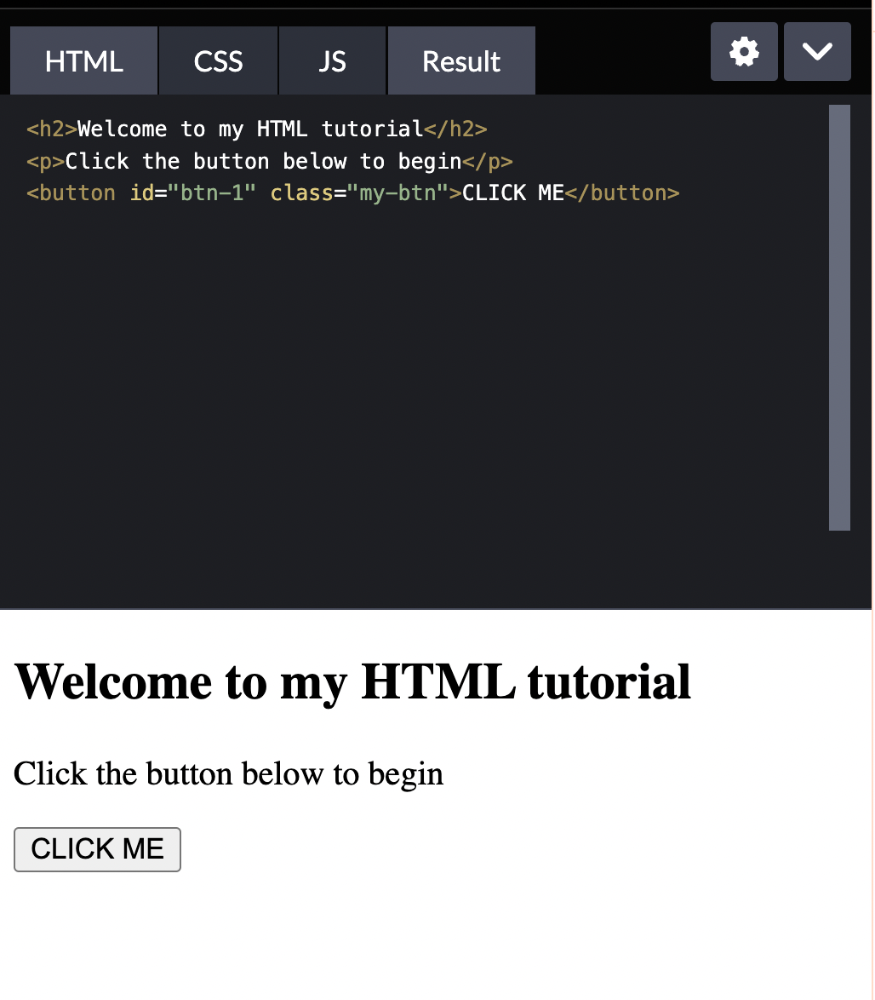

- (Step 1) There are multiple ways we could do to identify the element. Say the element we want to identify is the `<button></button>` element.
    - Use tag selector: `document.querySelector('button')`. We refer to the tag directly by the tag `button`.
        - This will look through the whole HTML file and find the first occurance of the `<button>` tag.
        - If it doesn't find it, it will return null.
    - Use class selector: `document.querySelector('.my-btn')`. We refer to the class using `.`.
    - Use id selector: `document.querySelector('#btn-1')`. We refer the id using `#`.
        - or we could also use `document.getElementById('btn-1')` (<a href="https://developer.mozilla.org/en-US/docs/Web/API/Document/getElementById">getElementById documentation</a>).
        - Selecting element using id is the most specific way to do it, because we can not have multiple elements with the same id -- if we do this, it will cause conflict.
        - We want to always try to be as specific as we can when identifying element within the DOM.
    - Notice that all querySelector we did below gave the same element.
    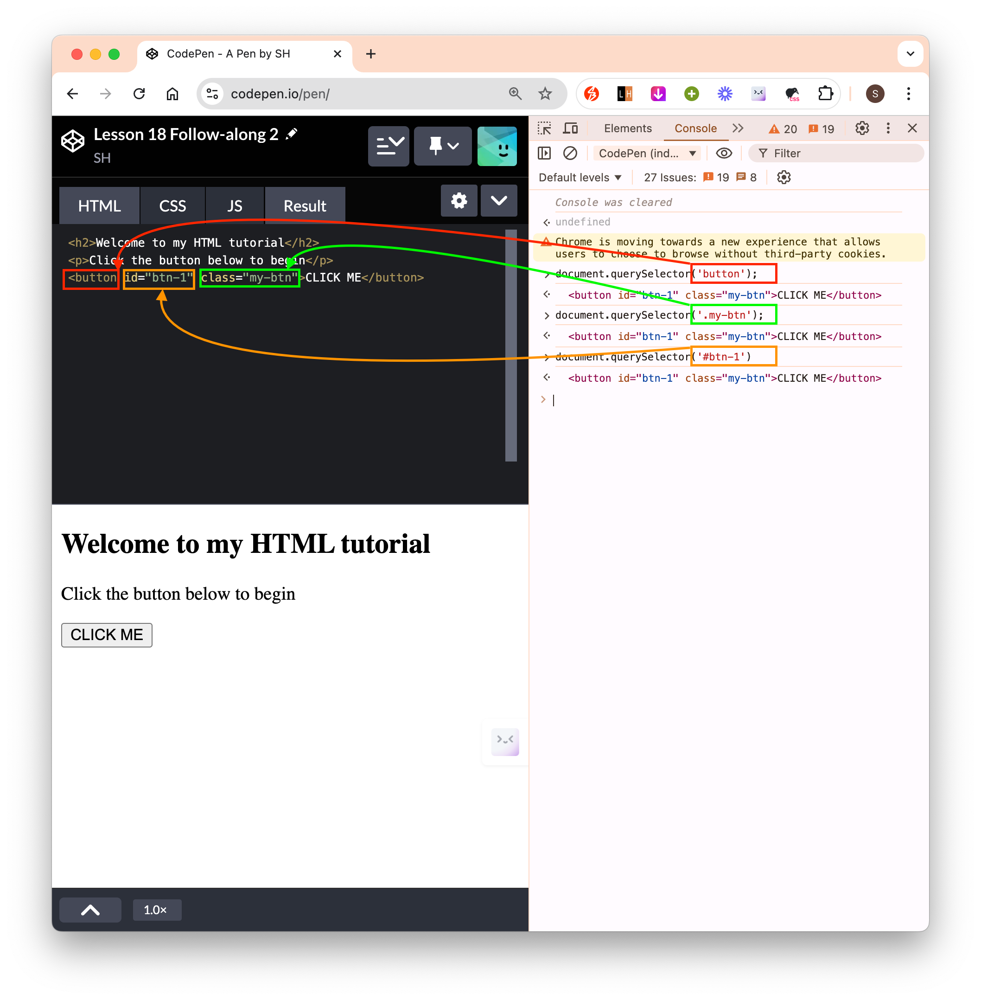
    - Additional ways to do the same thing:
    
    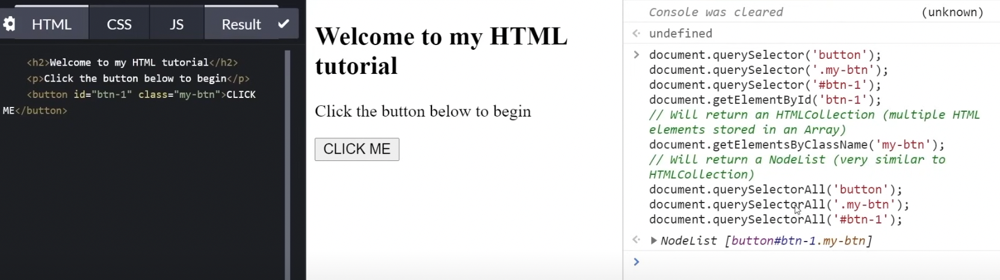
    - Refer to this when trying to select element by tag/id/class.
    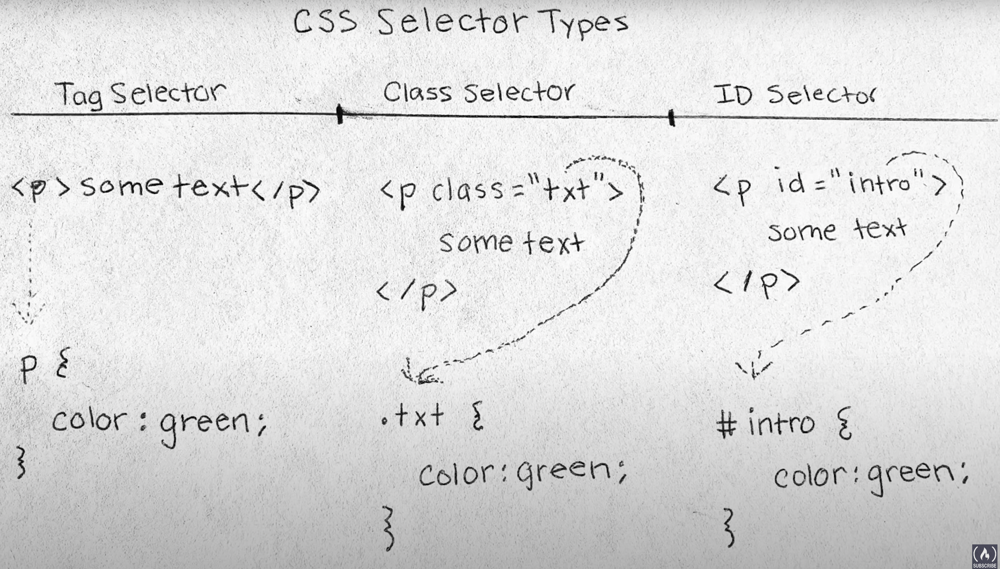

- (Step 2) Register click event. There are 3 ways to do this:
    - In Javascript section:
        ```
        // button we want to add click event to
        const btn = document.querySelector('#btn-1');

        // the function we want to execute when user click on the button (right now it is empty)
        function addParagrah() {
        }

        // method 1
        btn.addEventListener('click', addParagraph)

        // method 2
        btn.onclick = addParagraph; // syntax {name of element}.{event handler property - see doc!}
        ```
        - Check out the <a href="https://developer.mozilla.org/en-US/docs/Web/Events">Event documentation </a> to see what events we can add.
    - In HTML section:
        ```
        // add onclick attribute and set it to refer to the function we want to call
        <button id="btn-1" class="my-btn" onclick="addParagrah()">CLICK ME</button>
        ```
    - We can test if the implementation is working by printing some text on the console.
    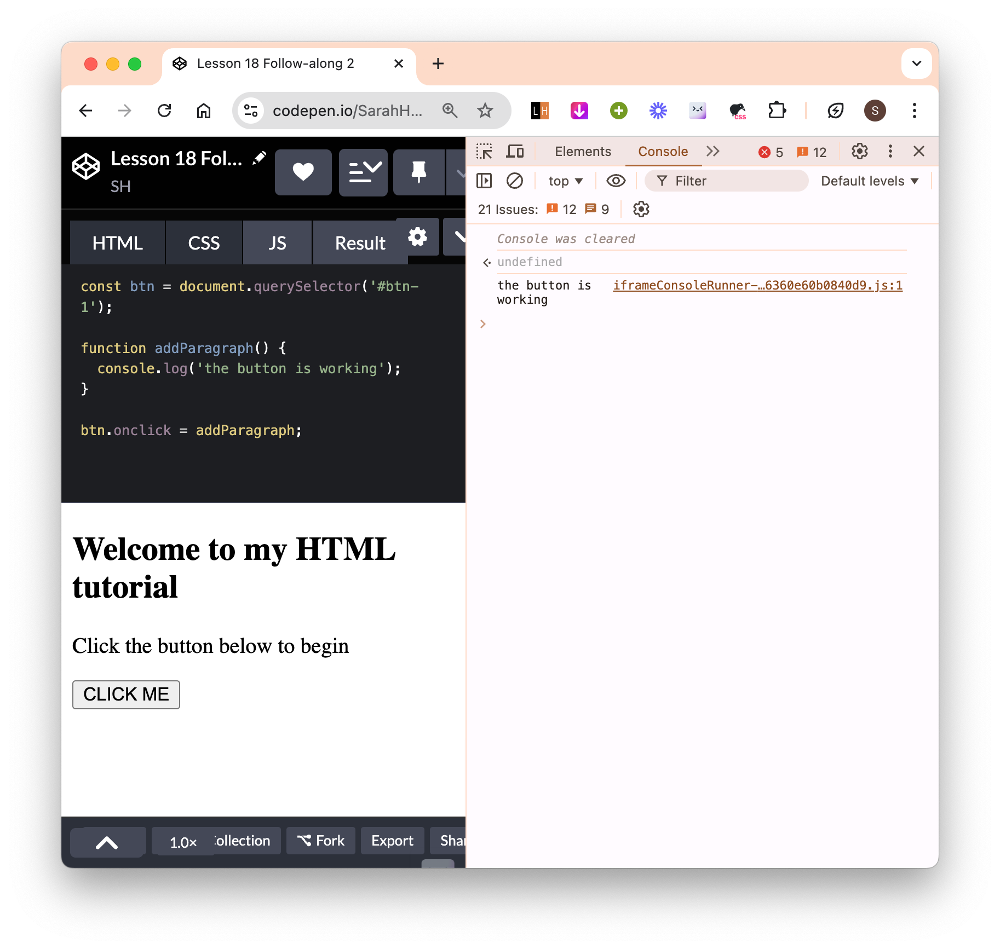
- (Step 3) Create a function that will be called upon user interaction. Here, our function is `addParagraph()` in the Javascript section. Below is the final implementation, notice that new paragraph is added to the end of the document everytime we click the button.
    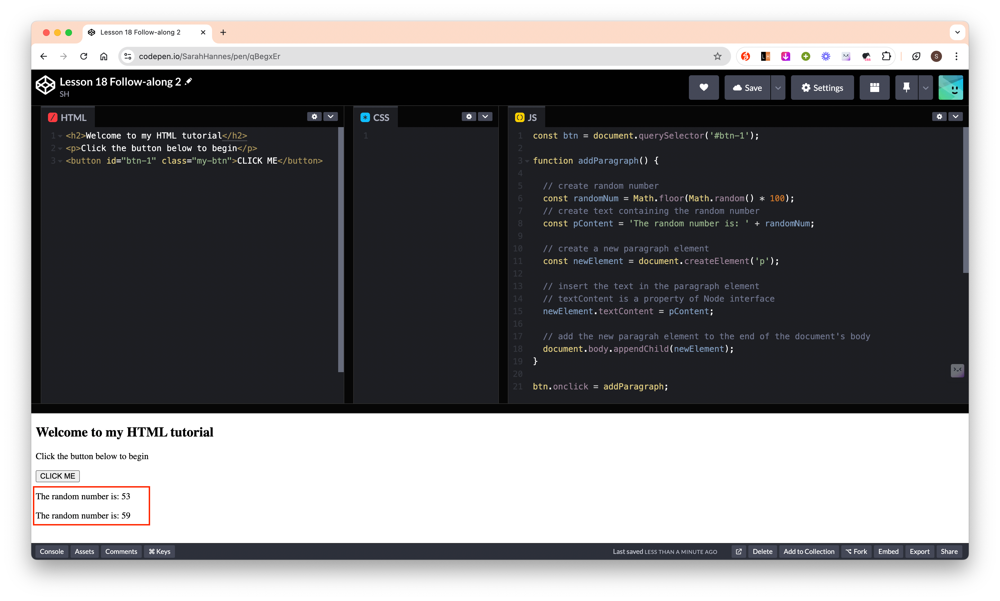

## Navigating through HTML document
- Say we want to know what type of a variable we're working with. What we can do is to save the element in a variable using Javascript then check its type using `.nodeType`. We can then check the node type in the <a href="https://developer.mozilla.org/en-US/docs/Web/API/Node/nodeType">MDN documentation</a> (the simplest way to do this is to search "NodeType" on the search bar). Once we know what the node type we're dealing with, we can then lookup its properties and attributes etc. Eg here, we get value of 1 from `list.nodeType`, and from the documentation, we know this is an element node.
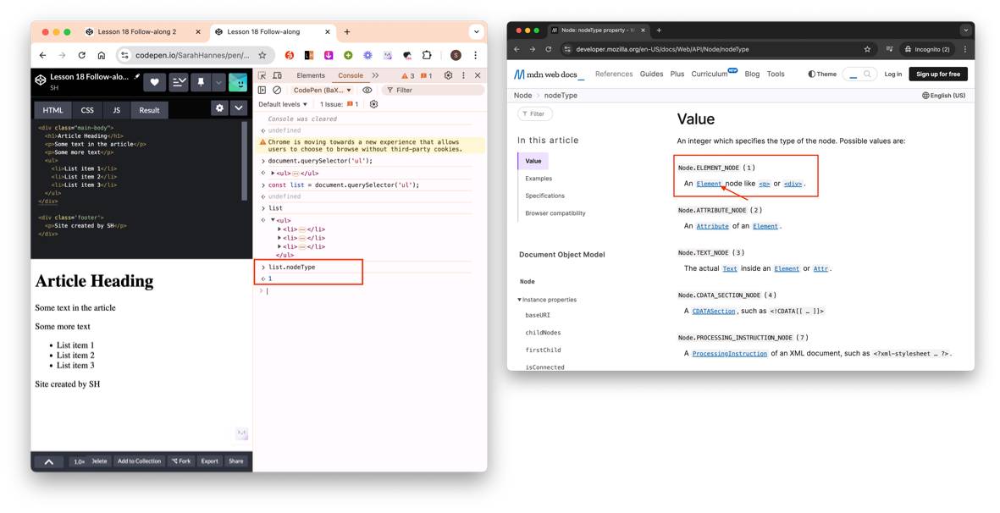
- Make changes using Javascript
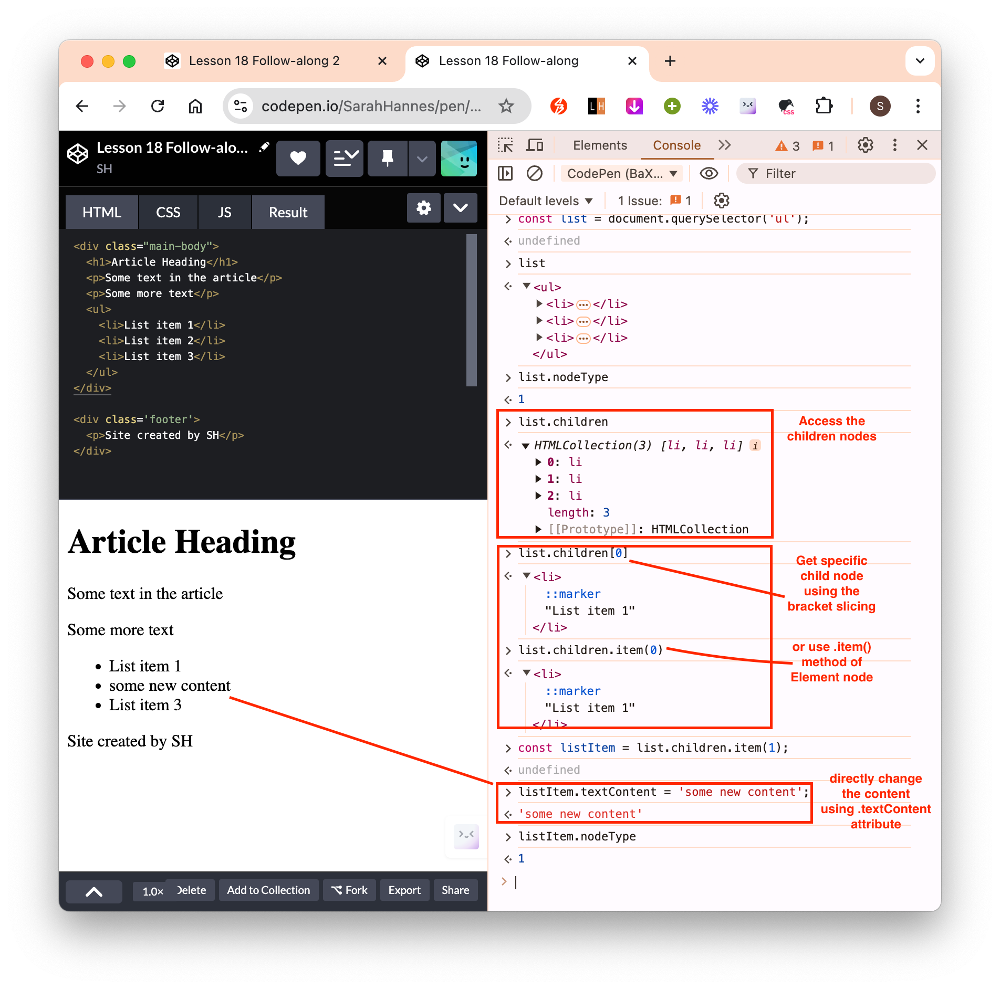
- Add new element using Javascript
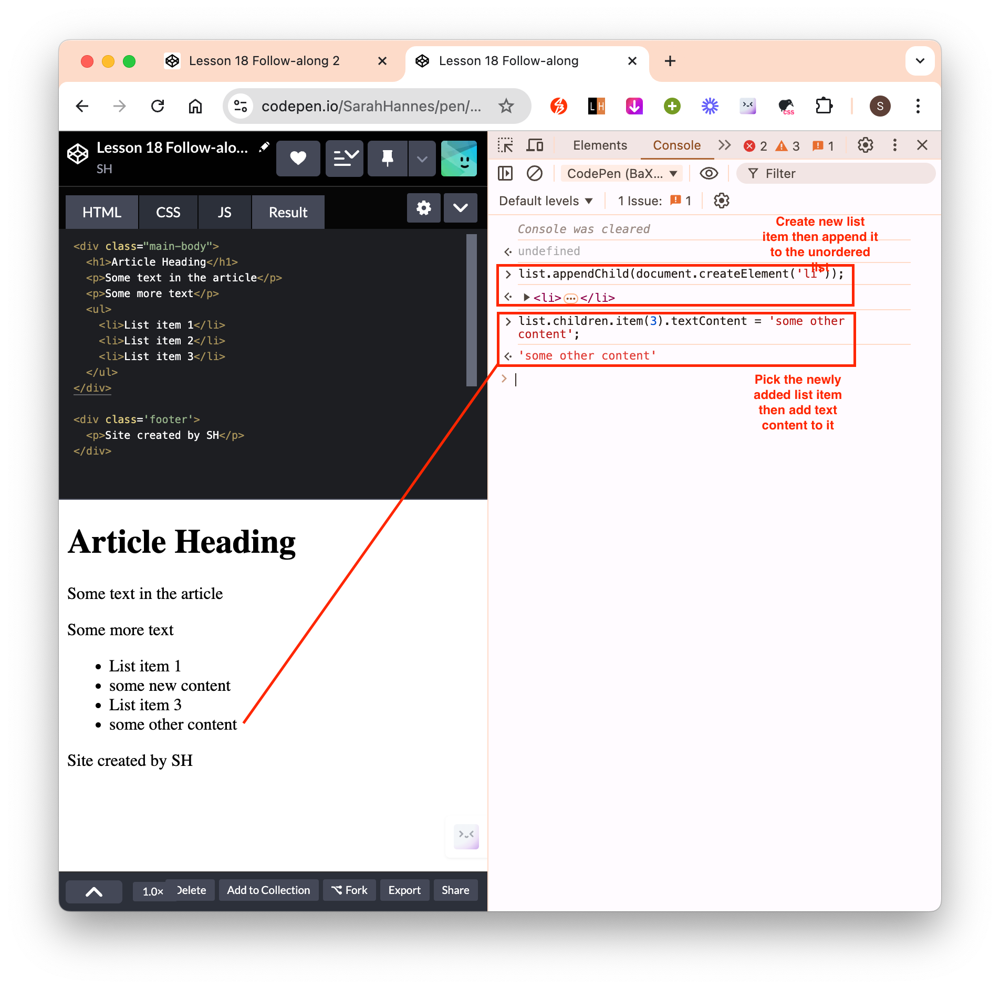
- Add new element using Javascript when we want to insert in between tags that has no specific id/class.
    - From Node interface documentation, we know we can use <a href="https://developer.mozilla.org/en-US/docs/Web/API/Node#:~:text=hasChildNodes()-,insertBefore(),-isDefaultNamespace()">`.insertBefore()`</a> method to add a new element before an existing element. 
    - From the documentation, the syntax guide for this method is `parent element.insertBefore(newNode to insert, referenceNode we want to insert before)`.
    - Say, we wanted to insert a new paragraph in between the 2 paragraphs tags that has no class/id that we could identify it by. The diagram below show how we can solve this step-by-step.
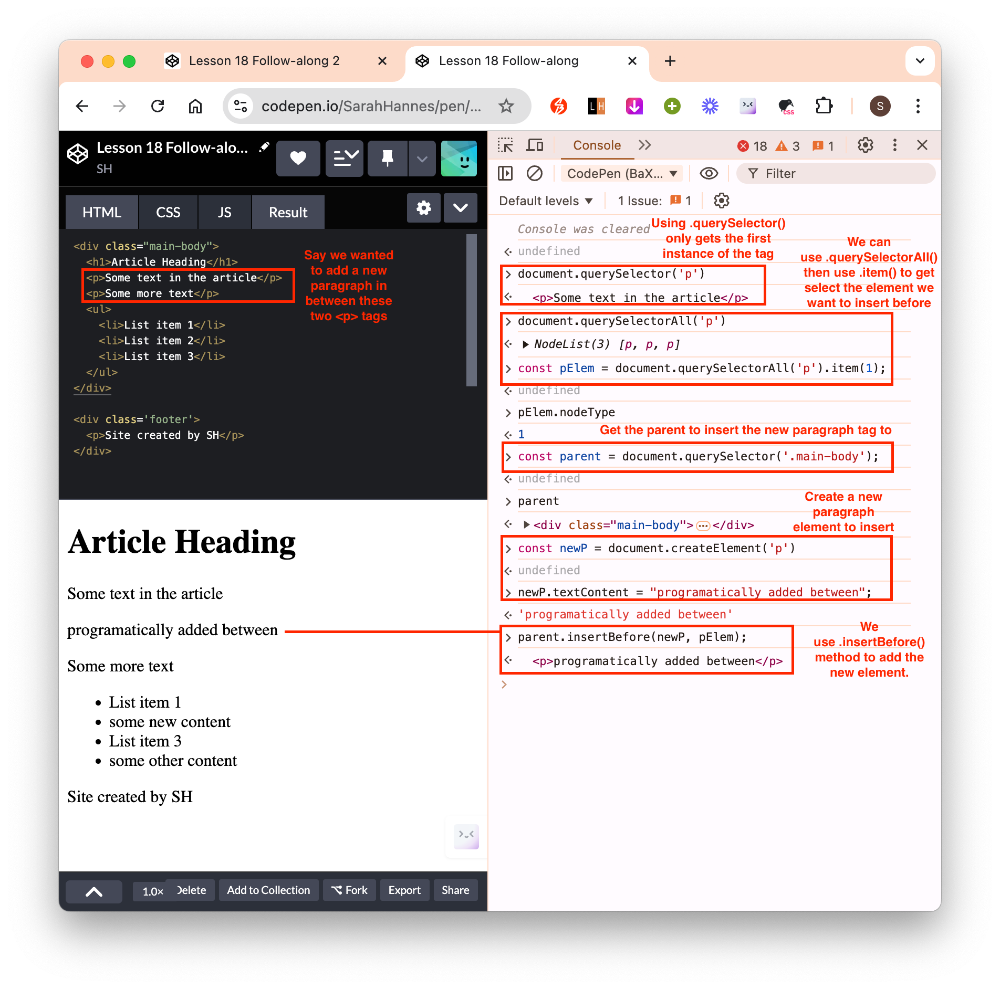
- Everything in the DOM is inherited from <a href="https://developer.mozilla.org/en-US/docs/Web/API/Node">Node</a> interface (think of object oriented program concept).
    - Which means everything below it (Element, HTMLElement etc) have access to its parent's (Node) attributes, properties, methods etc on top of their own attributes, properties, methods etc.

## Quick recap
- We can think of HTML in 2 different parts:
    - Static HTML: This is the HTML we see below. No matter what we do, this will not change.
    
    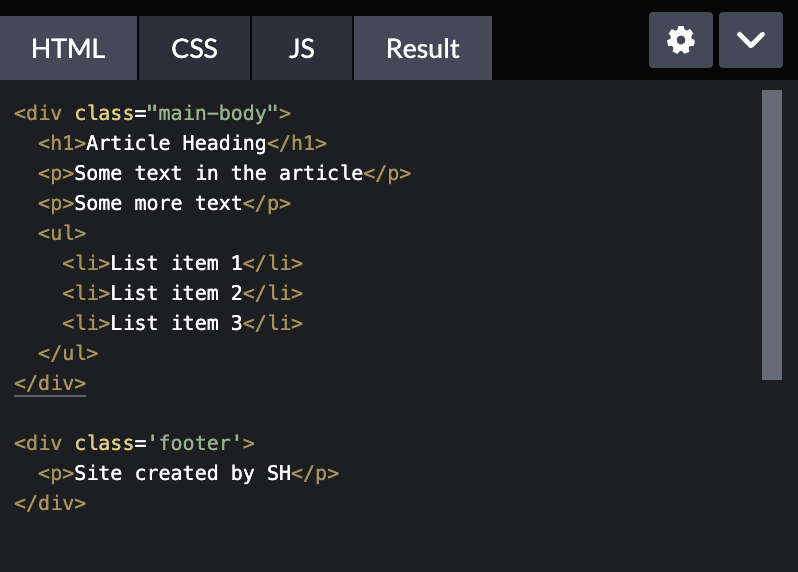
    
    - Dynamic HTML: This is what we see when we start working with the DOM to add/modify/remove etc elements with the existing static HTML.
- Key takeaway:
    - We can model a HTML document in a predictable way.
    - We can write specification called the document object model and allow Javascript to connect in with that API to actually modify the static HTML.
    - In the new HTML 5 spec, we should use HTML tag for both structure and intent. Eg instead of sectioning different part of a webpage in just `<div></div>` element, there are new tags available that we should use to better structure our webpage. Eg `<nav></nav>`, `<section></section>`, `<main></main>`, `<article></article>`, `<footer></footer>`. This is called semantic HTML.
    
        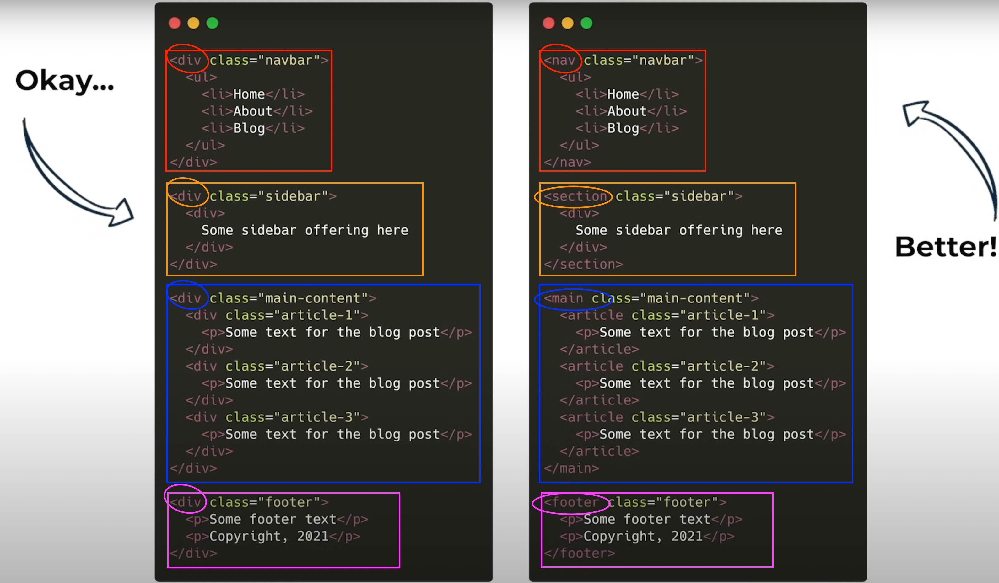

## Reference
- <a href="https://developer.mozilla.org/en-US/docs/Web/API/Document_Object_Model">MDN/Document Object Model (DOM)</a>: DOM documentation
- <a href="https://developer.mozilla.org/en-US/docs/Web/Events">MDN/Events</a>: List of events we could to elements on the web.
- <a href="https://developer.mozilla.org/en-US/docs/Web/API/Node">MDN/Node</a>: List of properties and methods of Node interface object
- <a href="https://developer.mozilla.org/en-US/docs/Web/API/Node/nodeType">MDN/nodeType</a>: List of node types and its corresponding values